In [2]:
# Basic Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
sb.set() # set the default Seaborn style for graphics

In [3]:
combined_annual_data = pd.read_excel("Combined All Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall = pd.read_excel("Combined Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)
combined_changed_data_together_overall_percent = pd.read_excel("Combined % Change Data.xlsx", usecols=lambda x: 'Unnamed' not in x)

In [27]:
annual_live_birth = combined_annual_data.iloc[:, :2]
annual_live_birth

,Year,number of live_birth in the year
0,1960-01-01,61775
1,1961-01-01,59930
2,1962-01-01,58977
3,1963-01-01,59530
4,1964-01-01,58217
...,...,...
58,2018-01-01,39039
59,2019-01-01,39279
60,2020-01-01,38590
61,2021-01-01,38672


In [28]:
live_birth_annual_change = pd.DataFrame(columns=["Year_Month", "Change in Live Birth"])
for i in range(1, annual_live_birth.shape[0]):
    if ((annual_live_birth.iloc[i, 1] - annual_live_birth.iloc[i-1, 1]) > 0):
        change = "INCREASE"
    else:
        change = "DECREASE"
    live_birth_annual_change.loc[i] = [annual_live_birth.iloc[i, 0], change]   
live_birth_annual_change

,Year_Month,Change in Live Birth
1,1961-01-01,DECREASE
2,1962-01-01,DECREASE
3,1963-01-01,INCREASE
4,1964-01-01,DECREASE
5,1965-01-01,DECREASE
...,...,...
58,2018-01-01,DECREASE
59,2019-01-01,INCREASE
60,2020-01-01,DECREASE
61,2021-01-01,INCREASE


## XGBoost Default Parameters (Raw Data)

In [36]:
from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

#from numpy import loadtxt
#from xgboost import XGBClassifier
from xgboost import plot_tree
from matplotlib.pylab import rcParams

Average over 1000 tries, Accuracy: 57.36%


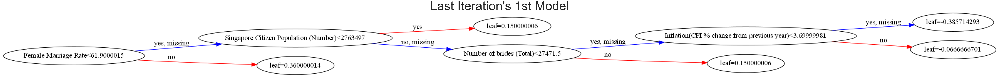

In [36]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = combined_annual_data_temp.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Default Parameters (Change Data)

Average over 1000 tries, Accuracy: 87.28%


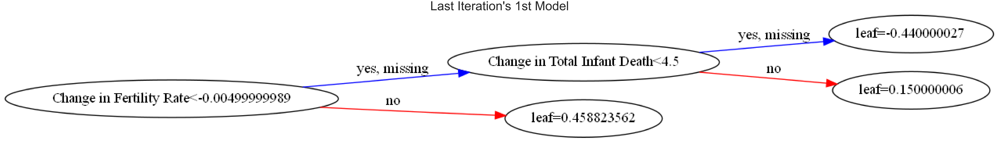

In [37]:
temp_X = combined_changed_data_together_overall.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Default Parameters (% Change Data)

Average over 1000 tries, Accuracy: 87.82%


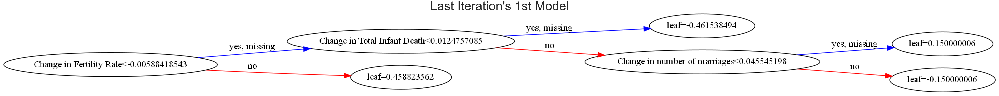

In [38]:
temp_X = combined_changed_data_together_overall_percent.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier()
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (Raw Data)

Average over 1000 tries, Accuracy: 61.40%


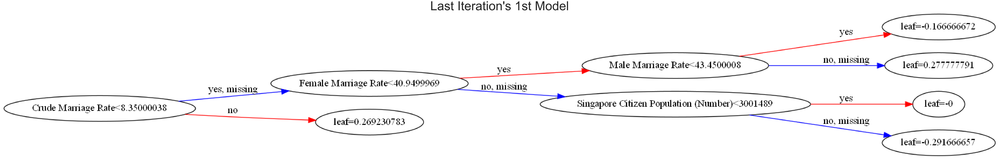

In [54]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = combined_annual_data_temp.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (Change Data)

Average over 1000 tries, Accuracy: 89.47%


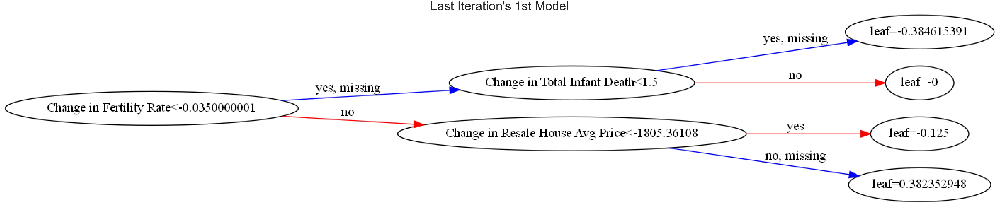

In [56]:
temp_X = combined_changed_data_together_overall.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost Tuned Hyperparameters (% Change Data)

Average over 1000 tries, Accuracy: 90.23%


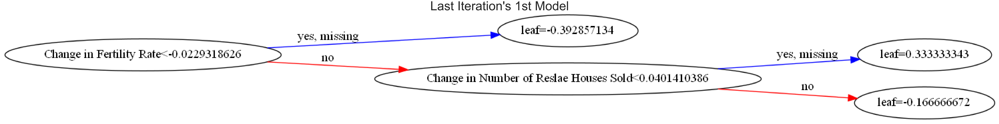

In [57]:
temp_X = combined_changed_data_together_overall_percent.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)
#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

all_accuracy = []

for i in range(1000):
    # Split the Dataset into Train and Test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    #print(y_train)
    y_train = le.fit_transform(y_train)
    ##print(type(y_train))

    # fit model no training data
    model = XGBClassifier(max_depth=3,gamma=0.2,eta=0.25)
    model.fit(X_train, y_train)

    # make predictions for test data
    y_test = le.fit_transform(y_test)

    y_pred = model.predict(X_test)
    predictions = [round(value) for value in y_pred]

    # evaluate predictions
    accuracy = accuracy_score(y_test, predictions)
    all_accuracy.append(accuracy)
    ## print("Accuracy: %.2f%%" % (accuracy * 100.0))
    #y_train
print("Average over 1000 tries, Accuracy: %.2f%%" % (sum(all_accuracy)/1000 * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

## XGBoost GridSearchCV (Raw Data)

In [47]:
combined_annual_data_temp = combined_annual_data.iloc[1:,:].copy()
combined_annual_data_temp.insert(1, live_birth_annual_change.columns[1], live_birth_annual_change.iloc[:, 1])

temp_X = combined_annual_data_temp.copy()
##temp_X.fillna(temp_X.mean(), inplace=True)
##temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

#"live births no.", "Total Infant Deaths", "number of marriages", "CPI values(seasonally adjusted)", "CPI values(non-seasonally adjusted)", "Inflation(CPI % change from previous month, seasonally adjusted)", "Inflation(CPI % change from previous month, non-seasonally adjusted)", "Resale House Avg Price", "Resale Houses Sold"

# Extract Response and Predictors
y = combined_annual_data_temp["Change in Live Birth"]
X = pd.DataFrame(temp_X.drop(columns=["Year", "number of live_birth in the year", 'Change in Live Birth'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200], 
          #'bootstrap':[True, False],
            'eta':[0.1,0.15,0.2,0.25,0.3],
             'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(),param_grid=param 
                     , cv=3) ## 3 for annual, due to no. of data points?



grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.6968253968253967
{'eta': 0.1, 'gamma': 0.1, 'max_depth': 3, 'n_estimators': 100}


## XGBoost GridSearchCV (Change Data)

In [45]:
temp_X = combined_changed_data_together_overall.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall_percent['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200], 
          #'bootstrap':[True, False],
            'eta':[0.1,0.15,0.2,0.25,0.3],
             'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(),param_grid=param 
                     , cv=3) ## 3 for annual, due to no. of data points?



grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.9301587301587301
{'eta': 0.1, 'gamma': 0.1, 'max_depth': 3, 'n_estimators': 50}


## XGBoost GridSearchCV (Raw Data)

In [48]:
temp_X = combined_changed_data_together_overall_percent.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X
temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall_percent['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train = le.fit_transform(y_train)

from sklearn.model_selection import GridSearchCV

param = {'max_depth': [3,5,6,9, None], 
         'n_estimators':[50, 70, 100, 150, 200], 
          #'bootstrap':[True, False],
            'eta':[0.1,0.15,0.2,0.25,0.3],
             'gamma':[0.1,0.2,0.3,0.4]}

grid_model = GridSearchCV(XGBClassifier(),param_grid=param 
                     , cv=3) ## 3 for annual, due to no. of data points?



grid_model.fit(X_train,y_train)
print(grid_model.best_score_)
print(grid_model.best_params_)

0.9555555555555556
{'eta': 0.1, 'gamma': 0.1, 'max_depth': 3, 'n_estimators': 50}


## SHAP and LIME Feature Evaluation

Accuracy: 94.74%


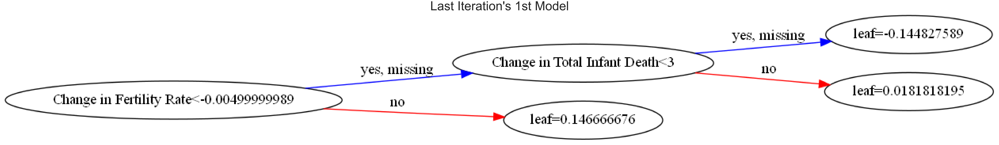

data row 5
Intercept 0.3437251800251357
Prediction_local [0.65511003]
Right: 0.9098736


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Fertility Rate,0.326541
1,Change in Total Infant Death,0.013534
2,Change in Resident Population,0.010242
3,Change in Female Residents Aged 20-39,0.007959
4,Change in Female Marriage Rate,0.007706
5,Change in Median Monthly Household Income,0.007206
6,Change in Average Full-Time Working Hours per ...,-0.007110
7,Change in Old-Age Dependency Ratio of Citizens...,-0.007033
8,Change in Total Brides Aged under 39,0.006498
9,Change in Permanent Resident Population,-0.003317






data row 8
Intercept 0.3361919425728659
Prediction_local [0.29426189]
Right: 0.038401544


,Feature,Contribution
0,Change in Fertility Rate,0.321839
1,Change in Total Infant Death,0.011782
2,Change in Female Residents Aged 20-39,0.008575
3,Change in Total Residents,-0.006330
4,Change in Permanent Resident Population,-0.005838
5,Changes in Total Brides,0.004171
6,Change in Number of Reslae Houses Sold,0.003254
7,Change in Total Brides Aged under 39,0.002568
8,Change in Old-Age Support Ratio of Citizens Ag...,-0.002422
9,Change in number of marriages,0.002023






data row 11
Intercept 0.34477161248396976
Prediction_local [0.36184542]
Right: 0.06945788


,Feature,Contribution
0,Change in Fertility Rate,0.321261
1,Change in Total Infant Death,0.011269
2,Change in Females' Average Schooling Years,-0.008091
3,Change in Total Brides Aged under 39,0.008020
4,Change in Unemployment Rate,-0.006539
5,Change in number of marriages,0.006380
6,Change in CPI,-0.003951
7,Change in Males' Average Schooling Years,0.003720
8,Change in Old-Age Support Ratio of Citizens Ag...,0.003368
9,Change in Average Full-Time Working Hours per ...,0.000981






data row 15
Intercept 0.3443779087570989
Prediction_local [0.44978695]
Right: 0.3489772


,Feature,Contribution
0,Change in Fertility Rate,0.313979
1,Change in Total Infant Death,0.022149
2,Change in Total Residents,-0.009317
3,Change in Permanent Resident Population,-0.006581
4,Change in CPI,-0.005629
5,Change in Average Full-Time Working Hours per ...,0.004378
6,Change in Total Population,-0.004345
7,Change in Median Monthly Household Income,-0.003358
8,Change in Median Income,0.002514
9,Change in Non-Resident Population,-0.002366






data row 18
Intercept 0.33789813848480604
Prediction_local [0.46550056]
Right: 0.11433185


,Feature,Contribution
0,Change in Fertility Rate,0.319374
1,Change in Unemployment Rate,-0.012545
2,Change in Total Infant Death,0.012170
3,Change in Female Residents Aged 20-39,0.008901
4,Change in Overall Average Schooling Years,-0.006719
5,Change in Resident Population,-0.006618
6,Change in People with Minimum Education,-0.006430
7,Change in Males' Average Schooling Years,-0.005680
8,Change in Permanent Resident Population,-0.004913
9,Change in Old-Age Dependency Ratio of Citizens...,-0.003209


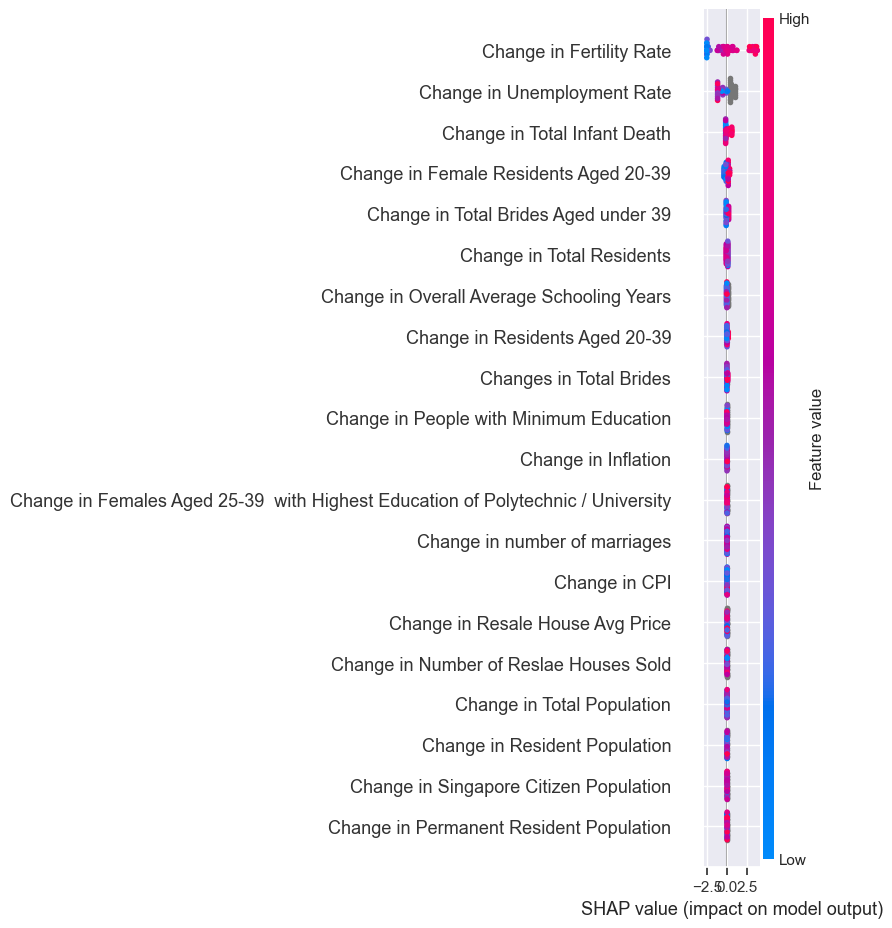

In [37]:
temp_X = combined_changed_data_together_overall.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

Accuracy: 94.74%


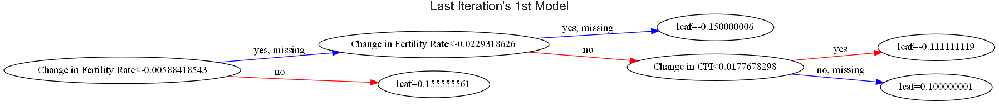

data row 4
Intercept 0.425008964767625
Prediction_local [0.34559719]
Right: 0.048622612


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Fertility Rate,0.343608
1,Change in CPI,0.012931
2,Change in Female Residents Aged 20-39,0.010624
3,Change in Total Brides Aged under 39,0.010409
4,Change in Resident Population,0.004791
5,Change in Total Population,0.004664
6,Change in Females' Average Schooling Years,0.003495
7,Change in Inflation,-0.003396
8,Change in Residents Aged 20-39,0.002714
9,Change in Population with Highest Education of...,-0.000865






data row 6
Intercept 0.42418482107998845
Prediction_local [0.40520082]
Right: 0.08797552


,Feature,Contribution
0,Change in Fertility Rate,0.347035
1,Change in CPI,0.011561
2,Change in Residents Aged 20-39,0.010863
3,Change in Total Infant Death,0.010637
4,Change in Total Population,0.009093
5,Change in Old-Age Support Ratio of Citizens Ag...,0.007553
6,Change in Median Income,0.004726
7,Change in Unemployment Rate,-0.003943
8,Change in Permanent Resident Population,0.003405
9,Change in Median Monthly Household Income,0.002443






data row 14
Intercept 0.4241711185609752
Prediction_local [0.49744168]
Right: 0.82024616


,Feature,Contribution
0,Change in Fertility Rate,0.345701
1,Change in Total Infant Death,0.013928
2,Change in Female Residents Aged 20-39,0.013112
3,Change in Total Brides Aged under 39,0.012066
4,Change in number of marriages,0.010603
5,Change in Total Population,0.010521
6,Change in CPI,0.010338
7,Change in Crude Marriage Rate,0.010213
8,Change in Population with Highest Education of...,0.008919
9,Change in Residents Aged 20-39,0.006476






data row 15
Intercept 0.42046742153733163
Prediction_local [0.10306146]
Right: 0.033315163


,Feature,Contribution
0,Change in Fertility Rate,0.342684
1,Change in Female Residents Aged 20-39,0.011773
2,Change in Total Infant Death,0.010570
3,Change in Total Brides Aged under 39,0.009147
4,Change in Average Full-Time Working Hours per ...,0.007987
5,Change in Total Population,0.006212
6,Change in Residents Aged 20-39,0.006098
7,Change in Old-Age Dependency Ratio of Citizens...,-0.005960
8,Change in Resident Population,-0.003817
9,Change in Singapore Citizen Population,-0.002984






data row 17
Intercept 0.4235256293506007
Prediction_local [0.36935782]
Right: 0.07859337


,Feature,Contribution
0,Change in Fertility Rate,0.343284
1,Change in Total Brides Aged under 39,0.013320
2,Change in CPI,0.012089
3,Change in Total Infant Death,0.009329
4,Change in Number of Reslae Houses Sold,-0.007352
5,Change in Total Population,0.006147
6,Change in Females' Average Schooling Years,0.006094
7,Change in Median Monthly Household Income,0.006042
8,Change in Total Residents,-0.005971
9,Change in Female Residents Aged 20-39,0.004584


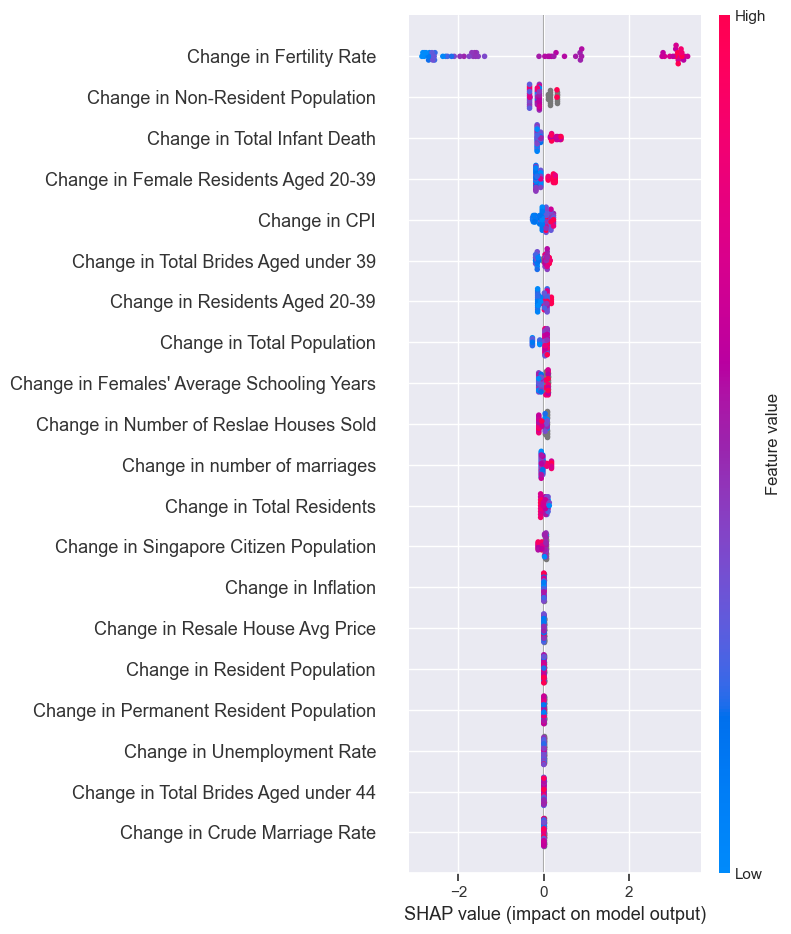

In [45]:
temp_X = combined_changed_data_together_overall_percent.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

## SHAP and LIME Feature Evaluation without Fertility Rate

### In our analysis, we calculated the SHAP values for each feature and visualized them using summary plots. The initial summary plot revealed that the fertility rate had a significant impact on the model for the annual datasets. Which is useful for predicting the change in the number of live births.

### However, as it is merely a symptom of the fertility rate. The model was not useful in identifying the causes of the change in birth numbers.

### As a result, we removed factors that could be a symptom of the birth number such as fertility rate and infant death from the model and ran it again. 

Accuracy: 78.95%


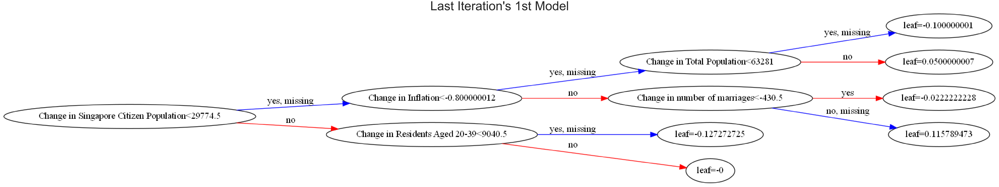

data row 1
Intercept 0.4949911066814822
Prediction_local [0.42184668]
Right: 0.48186502


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in People with Minimum Education,-0.107665
1,Change in Singapore Citizen Population,-0.081853
2,Change in Crude Marriage Rate,0.077143
3,Change in Non-Resident Population,0.035664
4,Change in Residents Aged 20-39,0.024785
5,Change in Population with Highest Education of...,0.016392
6,Change in Old-Age Support Ratio of Citizens Ag...,-0.011141
7,Change in Males' Average Schooling Years,-0.009671
8,Change in Old-Age Dependency Ratio of Citizens...,0.008127
9,Change in Total Population,0.006130






data row 7
Intercept 0.49592153855610116
Prediction_local [0.39398082]
Right: 0.37813115


,Feature,Contribution
0,Change in People with Minimum Education,-0.109783
1,Change in Crude Marriage Rate,0.079327
2,Change in Singapore Citizen Population,-0.078443
3,Change in Non-Resident Population,0.034232
4,Change in Residents Aged 20-39,0.031978
5,Change in Total Brides Aged under 39,0.029876
6,Change in Total Residents,-0.022179
7,Change in number of marriages,0.019637
8,Change in Population with Highest Education of...,0.016295
9,Change in Inflation,0.008163






data row 12
Intercept 0.4988331068707596
Prediction_local [0.60308335]
Right: 0.87649137


,Feature,Contribution
0,Change in People with Minimum Education,-0.110842
1,Change in Crude Marriage Rate,0.080144
2,Change in Singapore Citizen Population,-0.079131
3,Change in Non-Resident Population,0.034356
4,Change in Total Residents,-0.029448
5,Change in Residents Aged 20-39,0.025843
6,Change in Total Brides Aged under 39,0.025617
7,Change in number of marriages,0.020285
8,Change in Resale House Avg Price,-0.011567
9,Change in Old-Age Support Ratio of Citizens Ag...,-0.010604






data row 14
Intercept 0.4948357863026107
Prediction_local [0.30469185]
Right: 0.2555908


,Feature,Contribution
0,Change in People with Minimum Education,-0.109453
1,Change in Singapore Citizen Population,-0.079829
2,Change in Crude Marriage Rate,0.078508
3,Change in Non-Resident Population,0.030990
4,Change in number of marriages,0.026408
5,Change in Total Residents,-0.025539
6,Change in Total Brides Aged under 39,0.025138
7,Change in Residents Aged 20-39,0.021183
8,Change in Population with Highest Education of...,0.012500
9,Change in Old-Age Dependency Ratio of Citizens...,0.012006






data row 16
Intercept 0.5002572116753152
Prediction_local [0.49497765]
Right: 0.37734622


,Feature,Contribution
0,Change in People with Minimum Education,-0.113021
1,Change in Singapore Citizen Population,-0.081342
2,Change in Crude Marriage Rate,0.081048
3,Change in Total Brides Aged under 39,0.024710
4,Change in Residents Aged 20-39,0.023784
5,Change in number of marriages,0.019374
6,Change in Population with Highest Education of...,0.016334
7,Change in Average Full-Time Working Hours per ...,-0.014750
8,Change in Old-Age Dependency Ratio of Citizens...,0.009603
9,Change in Males' Average Schooling Years,-0.009283


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


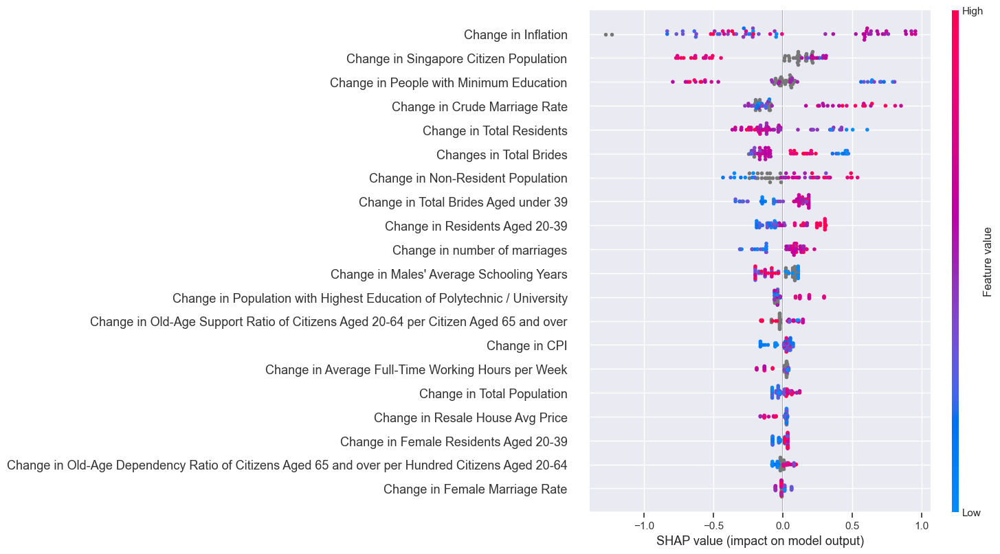

In [60]:
temp_X = combined_changed_data_together_overall.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number', 'Change in Fertility Rate', 'Change in Total Infant Death'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)

Accuracy: 78.95%


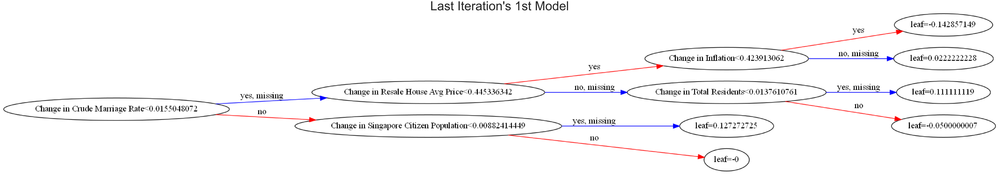

data row 3
Intercept 0.4854457320734837
Prediction_local [0.58120976]
Right: 0.52295554


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


,Feature,Contribution
0,Change in Old-Age Dependency Ratio of Citizens...,0.060427
1,Change in CPI,0.045438
2,Change in Total Residents,-0.038516
3,Change in Median Income,0.025455
4,Change in Overall Average Schooling Years,-0.025386
5,Change in Females' Average Schooling Years,0.024510
6,Change in Inflation,0.022213
7,Change in Non-Resident Population,0.014060
8,Change in People with Minimum Education,-0.013252
9,Change in Total Population,0.005948






data row 8
Intercept 0.4896778487783345
Prediction_local [0.46299559]
Right: 0.40116665


,Feature,Contribution
0,Change in Residents Aged 20-39,0.081874
1,Change in CPI,0.053628
2,Change in Old-Age Dependency Ratio of Citizens...,0.048909
3,Change in Total Residents,-0.033802
4,Change in Female Marriage Rate,0.033742
5,Change in Median Income,0.028041
6,Change in Females' Average Schooling Years,0.026412
7,Change in Inflation,0.020257
8,Change in Female Residents Aged 20-39,0.015488
9,Change in Population with Highest Education of...,0.005463






data row 13
Intercept 0.48926466735705193
Prediction_local [0.57677292]
Right: 0.6446441


,Feature,Contribution
0,Change in Residents Aged 20-39,0.082077
1,Change in CPI,0.053328
2,Change in Old-Age Dependency Ratio of Citizens...,0.045408
3,Change in Total Residents,-0.035519
4,Change in Overall Average Schooling Years,-0.024931
5,Change in Median Income,0.024414
6,Change in People with Minimum Education,-0.013735
7,Change in Female Residents Aged 20-39,0.013044
8,Change in Population with Highest Education of...,0.007141
9,Change in Old-Age Support Ratio of Citizens Ag...,-0.005460






data row 14
Intercept 0.49231556630380907
Prediction_local [0.49771539]
Right: 0.6556692


,Feature,Contribution
0,Change in Residents Aged 20-39,0.078145
1,Change in Singapore Citizen Population,-0.060988
2,Change in Old-Age Dependency Ratio of Citizens...,0.055555
3,Change in CPI,0.050698
4,Change in Crude Marriage Rate,0.037790
5,Change in Total Residents,-0.031914
6,Change in Females' Average Schooling Years,0.025803
7,Change in Overall Average Schooling Years,-0.021336
8,Change in Female Residents Aged 20-39,0.011570
9,Change in People with Minimum Education,-0.009171






data row 18
Intercept 0.4895504918765206
Prediction_local [0.50163505]
Right: 0.10840842


,Feature,Contribution
0,Change in Residents Aged 20-39,0.083390
1,Change in Singapore Citizen Population,-0.065240
2,Change in CPI,0.054220
3,Change in Old-Age Dependency Ratio of Citizens...,0.052923
4,Change in Total Residents,-0.034745
5,Change in Median Income,0.029882
6,Change in Overall Average Schooling Years,-0.026960
7,Change in Inflation,0.023680
8,Change in Female Residents Aged 20-39,0.014912
9,Change in People with Minimum Education,-0.009665


Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.


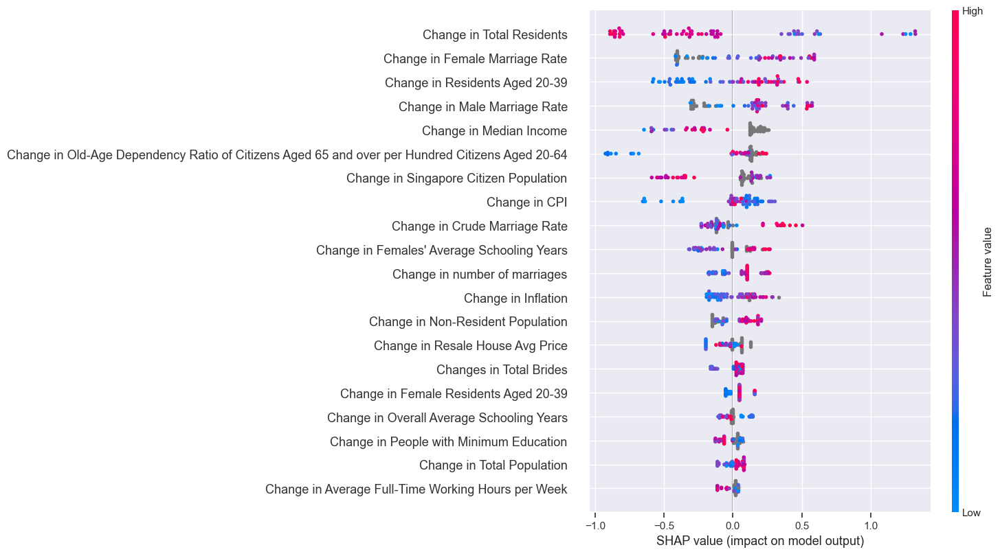

In [59]:
temp_X = combined_changed_data_together_overall_percent.copy()
#temp_X.fillna(temp_X.mean(), inplace=True)
#temp_X

temp_X.replace([np.inf, -np.inf], np.nan, inplace=True)

# Extract Response and Predictors
y = combined_changed_data_together_overall['Change in Live Birth']
X = pd.DataFrame(temp_X.drop(columns=["Year", "Change in Live Birth", 'Change in Live Birth Number', 'Change in Fertility Rate', 'Change in Total Infant Death'], axis = 1))

#X.fillna(X.mean, inplace=True)
#print(X)

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
#print(y_train)
y_train = le.fit_transform(y_train)
import numpy as np
##print(type(y_train))


# fit model no training data
model = XGBClassifier(max_depth=3, gamma=0.1, eta=0.1, n_estimators=50)
model.fit(X_train, y_train)

# make predictions for test data
y_test = le.fit_transform(y_test)

y_pred = model.predict(X_test)
predictions = [round(value) for value in y_pred]

# evaluate predictions
accuracy = accuracy_score(y_test, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

##set up the parameters
rcParams['figure.figsize'] = 100,75
plot_tree(model, rankdir="LR")
plt.title("Last Iteration's 1st Model", fontsize = 70)
plt.show()

import lime 
from lime import lime_tabular

import shap
shap.initjs()

shap_explainer = shap.TreeExplainer(model)
shap_values = shap_explainer.shap_values(X)

test_1 = X_test.iloc[3]

lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values[:,:],
    feature_names = X_train.columns,
    class_names=['DECREASE','INCREASE'],
    discretize_continuous=False,
    verbose=True)
i = 0
j = 0
while (i != 5):
    if (X_test.iloc[j].isnull().values.any()):
        j += 1
        continue
    print(f"data row {j+1}")
    lime_exp = lime_explainer.explain_instance(
        data_row=X_test.iloc[j,:],
        predict_fn=model.predict_proba
    )
    lime_exp.show_in_notebook(show_table=True)
    display(pd.DataFrame(lime_exp.as_list(),columns=['Feature','Contribution']))
    print()
    print()
    display(shap.force_plot(shap_explainer.expected_value, shap_values[1, :], X_test.iloc[0,:]))
    print()
    print()
    print()
    print()
    i += 1
    j += 1
shap.summary_plot(shap_values, X)